# Notebook to analyze features
To analyze features for certain utterances from sertain persons and investigate the waveforms, and images from the feature extraction process. 

### Imports 

In [1]:
%run project_setup.py 

import os
from IPython.display import Audio

from disvoice.articulation.articulation import Articulation
from disvoice.phonation.phonation import Phonation
from disvoice.prosody.prosody import Prosody

from constants import *
from functions import extend_paths

# DDK, words, sentences and monologue and vowels:
from possible_data_to_extract import *

2024-01-16 20:37:25.510233: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-16 20:37:25.510252: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-16 20:37:25.510998: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-01-16 20:37:25.515292: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-16 20:37:26.131207: W tensorflow/compiler/tf2

### Get data from PC-GITA
According to the utterances and features we want 

In [2]:
hc_paths = extend_paths(hc_paths_all, path_PC_GITA_16k)
pd_paths = extend_paths(pd_paths_all, path_PC_GITA_16k)


In [3]:
# Defining some functions
def find_path_from_paths(paths, key_term):
    """Finds paths that contain the key_term. 

    Args:
        paths (list): list of all paths before reduction
        key_term (string): key term that needs to be in the path for us to return that path. 

    Returns:
        list: list of paths that contain the key term
    """
    res = [elem for elem in paths if key_term in elem]
    if res != []:
        return res
    else:
        print("Could not find ", key_term)
        return False

def find_certain_files_from_all_files(hc_paths, pd_paths, health_status, u_type, d_type, id):
    """Returns all paths from either hc_paths or pd_paths that has the correct health 
    status, the correct utterance type, data type and id.

    Args:
        hc_paths (list): paths of all hc utterance types
        pd_paths (list): path of all pd utterance types
        health_status (string): either pd or hc
        u_type (string): utterance type, either Vowel, Words etc. 
        d_type (string): data type, either "/A", "viaje", etc. 
        id (string): person id, either "0001", "0002", etc. 

    Returns:
        list: list of all paths from either hc_paths or pd_paths that has the correct health 
    status, the correct utterance type, data type and id.
    """
    all_paths = hc_paths if health_status == "hc" else pd_paths
    paths = find_path_from_paths(all_paths, u_type)
    path = find_path_from_paths(paths, d_type)[0]
    
    waveforms = []
    for dirpath, dirnames, filenames in os.walk(path):  # Iterate through the directory
        for filename in filenames:
            filepath = os.path.join(dirpath, filename)
            waveforms.append(filepath)

    file = find_path_from_paths(waveforms, id)
    return file


In [4]:
# Choosing datatype and features

# Choosing datatype: // Look in possible_data_to_extract.py to see your choices. 
    # Will get a warning if you choose something not valid. 
health_status = "hc" # or pd
utterance_type = "monologue" # DDK, modulated_vowels, monologue, read_text, sentences, sentences2, Vowels or Words
data_type = "" # only "" if you just want the first option
id_nr = "0010" # only "" if you want all of them

file = find_certain_files_from_all_files(hc_paths, pd_paths, health_status, utterance_type, data_type, id_nr)

# If you just want to work with one element: 
# file=[file[0]]

print(file)
print("You now have ", len(file), " files.")

# Choosing which featuers we want to extract // Look in possible_features_to_extract.md to see your choices. 
choosen_features = {}
choosen_features["Articulation"] = articulation_all_features # ['avg BBEon_1', "avg MFCCon_1"]
choosen_features["Phonation"] = phonation_all_features # ['avg Shimmer', 'avg Jitter']
choosen_features["Prosody"] = prosody_all_features # ["avg1Evoiced", "avgEvoiced"]

['/localhome/studenter/malinre/project-thesis/PC-GITA-v2/PC-GITA_per_task_16000Hz/monologue/sin_normalizar/hc/AVPEPUDEAC0010_Monologo-NR.wav']
You now have  1  files.


### Listening to the audios: 

In [5]:
# file=path_PC_GITA_16k + '/Vowels/Patologicas/A/AVPEPUDEA0001_a1.wav'
# path=path_PC_GITA_16k + "/Vowels/Patologicas/A/"

for elem in file: 
    print(elem)
    display(Audio(elem,autoplay=False)) 

/localhome/studenter/malinre/project-thesis/PC-GITA-v2/PC-GITA_per_task_16000Hz/monologue/sin_normalizar/hc/AVPEPUDEAC0010_Monologo-NR.wav


### Extract phonation features

/localhome/studenter/malinre/project-thesis/PC-GITA-v2/PC-GITA_per_task_16000Hz/monologue/sin_normalizar/hc/AVPEPUDEAC0010_Monologo-NR.wav


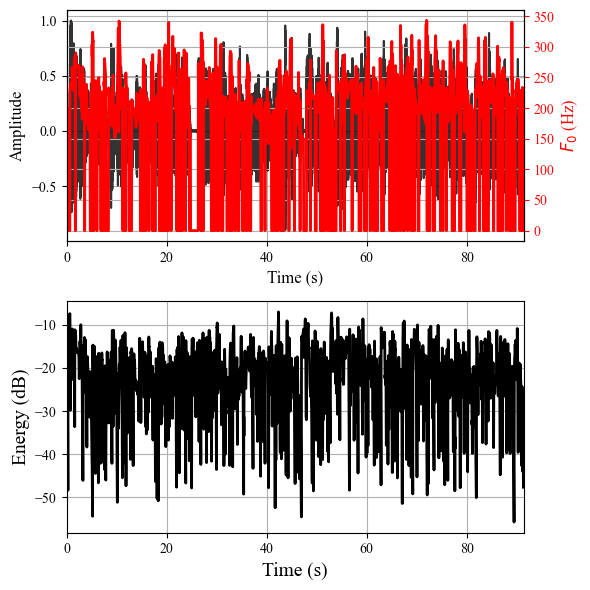

Chooosen features: 


,avg DF0,avg DDF0,avg Jitter,avg Shimmer,avg apq,avg ppq,avg logE,std DF0,std DDF0,std Jitter,...,skewness apq,skewness ppq,skewness logE,kurtosis DF0,kurtosis DDF0,kurtosis Jitter,kurtosis Shimmer,kurtosis apq,kurtosis ppq,kurtosis logE
0,0.004621,-0.004764,2.413878,5.794687,35.673535,2.557723,-22.490064,17.585207,27.166313,4.524709,...,1.076285,5.752812,-1.105979,29.745753,25.810021,37.789432,10.860929,1.489952,53.724853,1.189916


In [6]:
phonationf = Phonation()

for elem in file:
    print(elem)
    features_phonation=phonationf.extract_features_file(elem, static=True, plots=True, fmt="csv") 

    print("Chooosen features: ")
    # display(features_phonation[choosen_features["Phonation"]]) 
    display(features_phonation)

### Extract articulation features

/localhome/studenter/malinre/project-thesis/PC-GITA-v2/PC-GITA_per_task_16000Hz/monologue/sin_normalizar/hc/AVPEPUDEAC0010_Monologo-NR.wav


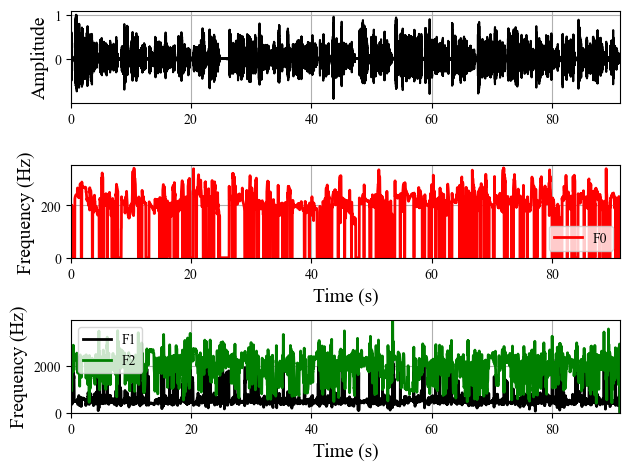

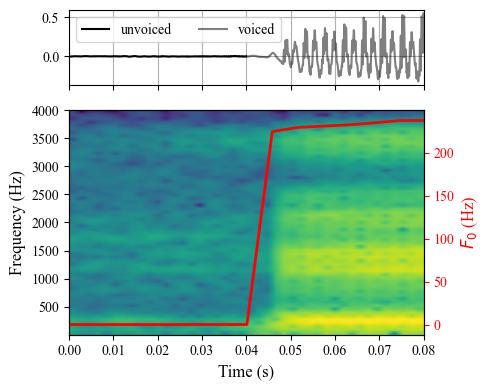

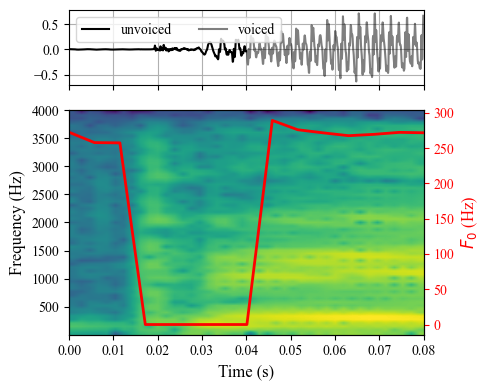

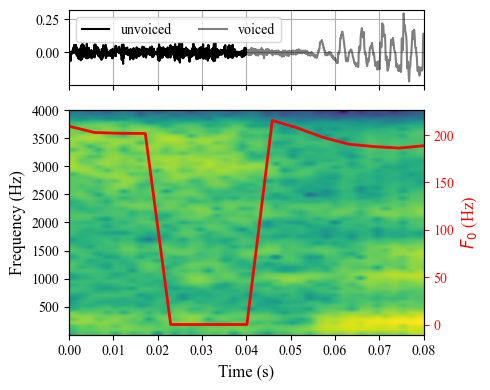

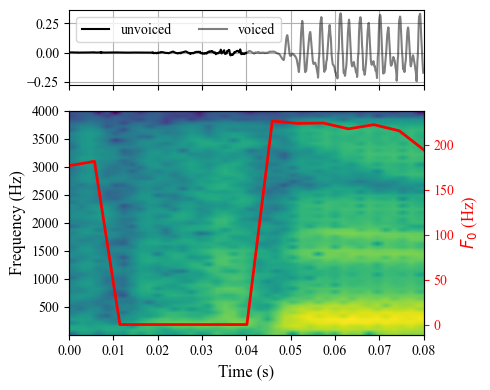

...

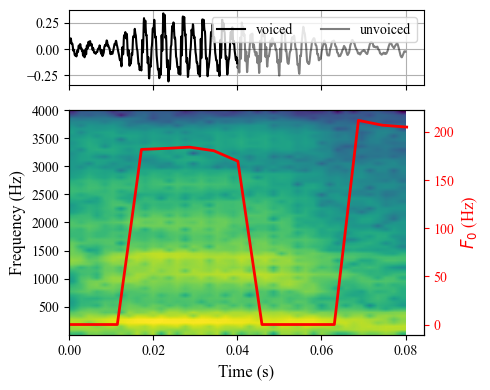

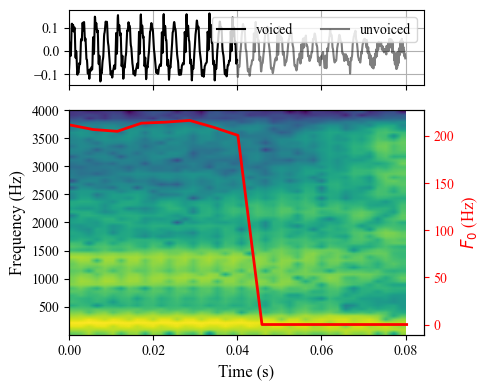

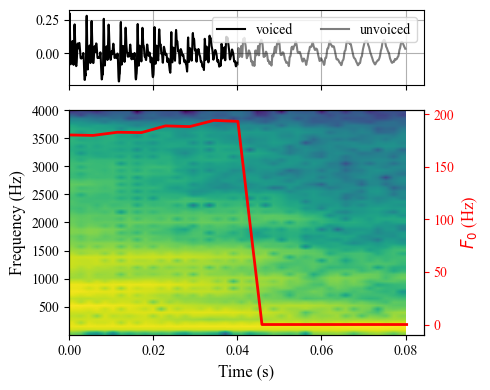

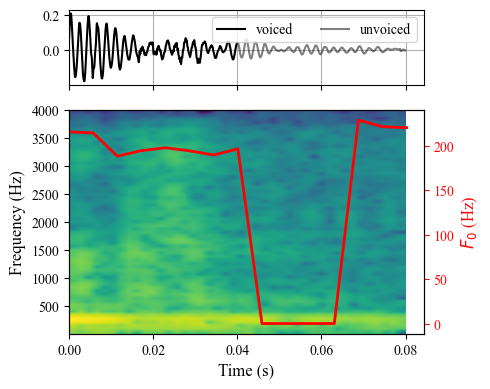

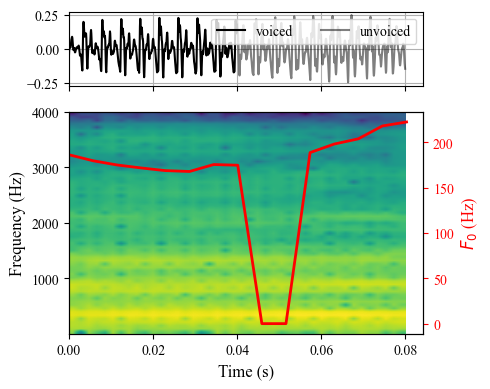

Chooosen features: 


,avg BBEon_1,avg BBEon_2,avg BBEon_3,avg BBEon_4,avg BBEon_5,avg BBEon_6,avg BBEon_7,avg BBEon_8,avg BBEon_9,avg BBEon_10,...,kurtosis DDMFCCoff_9,kurtosis DDMFCCoff_10,kurtosis DDMFCCoff_11,kurtosis DDMFCCoff_12,kurtosis F1,kurtosis DF1,kurtosis DDF1,kurtosis F2,kurtosis DF2,kurtosis DDF2
0,-3.360515,-2.078389,-1.757944,-1.589647,-1.703351,-2.141804,-2.887864,-3.686364,-3.999742,-4.325264,...,1.901544,0.571408,1.146926,1.064522,11.671568,14.577764,14.869968,-0.285128,7.856846,8.878008


In [7]:
articulationf=Articulation()

for elem in file:
    print(elem) 
    ## Extract static features and return them as a df 
    features_articulation=articulationf.extract_features_file(elem, static=True, plots=True, fmt="csv") # change plots = False til True for å plotte bilda. 

    print("Chooosen features: ")
    # display(features_articulation[choosen_features["Articulation"]]) 
    display(features_articulation)



In [8]:
# Other methods to extract features: 
print("All")
display(features_articulation) # features1 is a df and it is prettier when we use display. 

print("MEL")
display(features_articulation.iloc[:,22:34]) # The 12 Mel frequency cepstral coefficients in onset transitions

print("")
print("F1 and F2 and everything inbetween ")
display(features_articulation.loc[:, "avg F1":"avg F2"]) # Takes out all the features inbetween those 2 

print(" ")
print("avg BBEoff_1")
display(features_articulation["avg BBEoff_1"]) # Bark band energies in onset transitions, first example

All


,avg BBEon_1,avg BBEon_2,avg BBEon_3,avg BBEon_4,avg BBEon_5,avg BBEon_6,avg BBEon_7,avg BBEon_8,avg BBEon_9,avg BBEon_10,...,kurtosis DDMFCCoff_9,kurtosis DDMFCCoff_10,kurtosis DDMFCCoff_11,kurtosis DDMFCCoff_12,kurtosis F1,kurtosis DF1,kurtosis DDF1,kurtosis F2,kurtosis DF2,kurtosis DDF2
0,-3.360515,-2.078389,-1.757944,-1.589647,-1.703351,-2.141804,-2.887864,-3.686364,-3.999742,-4.325264,...,1.901544,0.571408,1.146926,1.064522,11.671568,14.577764,14.869968,-0.285128,7.856846,8.878008


MEL


,avg MFCCon_1,avg MFCCon_2,avg MFCCon_3,avg MFCCon_4,avg MFCCon_5,avg MFCCon_6,avg MFCCon_7,avg MFCCon_8,avg MFCCon_9,avg MFCCon_10,avg MFCCon_11,avg MFCCon_12
0,-3.411606,0.234003,1.849718,-3.061745,-3.694857,-0.94382,0.788291,-0.899802,1.129151,3.287382,-1.547172,0.422392



F1 and F2 and everything inbetween 


,avg F1,avg DF1,avg DDF1,avg F2
0,574.390646,-0.254056,0.12329,1915.051368


 
avg BBEoff_1


0   -3.109237
Name: avg BBEoff_1, dtype: float64

### Extract prosody features

/localhome/studenter/malinre/project-thesis/PC-GITA-v2/PC-GITA_per_task_16000Hz/monologue/sin_normalizar/hc/AVPEPUDEAC0010_Monologo-NR.wav


/localhome/studenter/malinre/miniconda3/envs/disenv/lib/python3.11/site-packages/disvoice/prosody/prosody.py:177: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(t, data_audio, 'k', label="speech signal",


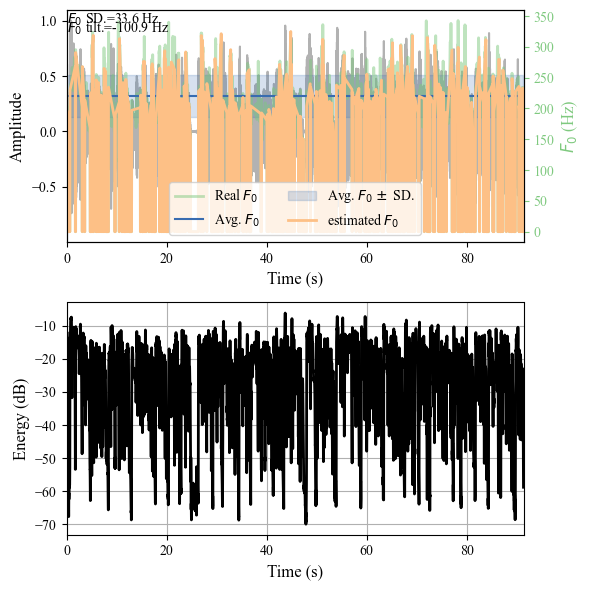

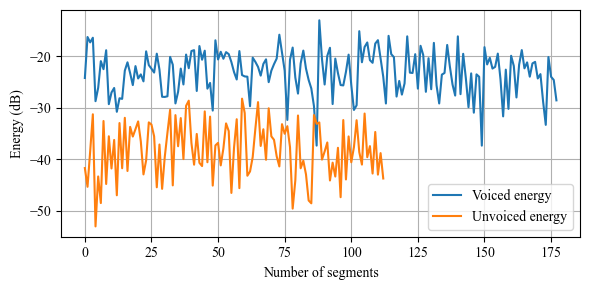

Chooosen features: 


,F0avg,F0std,F0max,F0min,F0skew,F0kurt,F0tiltavg,F0mseavg,F0tiltstd,F0msestd,...,skwdurpause,kurtosisdurpause,maxdurpause,mindurpause,PVU,PU,UVU,VVU,VP,UP
0,220.4534,33.607967,342.651672,82.845741,0.582846,0.523985,-100.861162,172.639355,275.127662,333.236956,...,3.330894,13.934203,1.56,0.15,0.896813,7.662302,0.117042,0.882958,0.984551,0.130509


In [9]:
prosodyf=Prosody()
for elem in file:
    print(elem)
    features_prosody=prosodyf.extract_features_file(elem, static=True, plots=True, fmt="csv")

    print("Chooosen features: ")
    # display(features_prosody[choosen_features["Prosody"]]) 
    display(features_prosody)

